In [1]:
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt 
import pandas as pd
from scipy import signal
from scipy.interpolate import PchipInterpolator
import glob
import os
from scipy.ndimage import gaussian_filter1d as gfilter


def hpts_writer(hpts_file,Nx=10,Ny=10,Nz=10):
    u,v,w = np.loadtxt(hpts_file,usecols=((1,2,3)),unpack=True)

    sp,s,sy= (Ny*Nz,Nx),(Nz,Ny,Nx),(Nz,Ny)

    u_2D, v_2D, w_2D = u.reshape(sp,order='F'),v.reshape(sp,order='F'),w.reshape(sp,order='F')

    # initialize arrays #
    u_3D,v_3D,w_3D = np.zeros(s),np.zeros(s),np.zeros(s)

    for idx in range(Nx):
        temp1,temp2,temp3 = u_2D[:,idx],v_2D[:,idx],w_2D[:,idx]
        u_3D[:,:,idx],v_3D[:,:,idx],w_3D[:,:,idx] = temp1.reshape(sy,order='F'), \
        temp2.reshape(sy,order='F'),temp3.reshape(sy,order='F')
        
        
    return u_3D, v_3D, w_3D

def time_avg(Pathname,filebase,Nx=10,Ny=10,Nz=10):
    
    temp = sorted(glob.glob(Pathname+'/*'))
    N_file = len(temp) 
    print(N_file)
    u_avg = np.zeros((Nz,Ny,Nx))
    for i in range(N_file):
        file = filebase+'_%04d.out'%(i)
        Path = os.path.join(Pathname,file)
        u,_,_ = hpts_writer(Path,Nx=Nx,Nz=Nz,Ny=Ny)
        u_avg += u
        print('summing file I=%d'%i)
    u_avg/=float(N_file)

    return u_avg

def z_avg(data_u):
    import numpy as np
    m,n,p = data_u.shape
    const=1.0/float(m)
    data_avg_u = np.zeros((n,p))
    
    for idz in range(m):
        data_avg_u[:,:]+= data_u[idz,:,:]
        
    data_avg_u *= const
    
    return data_avg_u

def signal_1D_refine(up,Lx,Nx):
    x = np.linspace(0.0,Lx,Nx,endpoint=True)
    x_int = np.linspace(0.0,Lx,64*(Nx-1)+1,endpoint=True)
    up_1D_func = PchipInterpolator(x,up)
    up_i = up_1D_func(x_int)
    
    return x_int,up_i
    

def windowed_correlation(u_signal,x,window_size):
    N_signal = len(u_signal)
    
    if(window_size > N_signal):
        raise(ValueError("window size should be smaller than length of the signal"))

    ## Default - 50% overlap of the window-size
    
    N_window_signal = (N_signal-1)//window_size
    if(N_window_signal != int((N_signal-1)/window_size)):
        raise(ValueError(" Window signal should evenly divide "))
      
    Nws = int(2*N_window_signal-2) # make it twice for 50% overlap
    x_bin,up_lags,up = [],[],[]
    
    for i in range(Nws):
        
        begin = int(i*window_size//2)
        end =   int(i*window_size//2+window_size)
        
        us = u_signal[begin:end]
        up_ = signal.correlate(us,us)
        up_ /= np.max(up_)
        up.append(up_)
        up_lags.append(signal.correlation_lags(len(us),len(us)))
        x_bin.append(0.5*(x[begin]+x[end]))
    return x_bin,up,up_lags
    
def z_avg_correlation(up_signal,Lx,window_size,iy):
    nz,ny,nx = np.shape(up_signal)
    xi,up0 = signal_1D_refine(up[0,0,:],Lx,nx)
    nxi = len(up0)
    upi_signal = np.zeros((nz,nxi))

    for iz in range(nz):
        _,upi = signal_1D_refine(up[iz,iy,:],Lx,nx)
        print("Refining stream-signal for iz=%d"%iz)
        upi_signal[iz,:] = upi
        
    x_bin,temp,u_Lag = windowed_correlation(upi_signal[0,:],xi,window_size) # dummy call
    u_avg_corr = np.array(temp)
    Nx_bin, N_lag = np.shape(u_avg_corr)
    ucorr_window = np.zeros((nz,Nx_bin,N_lag))
    
    
    for iz in range(nz):
        _,u_corr,_ = windowed_correlation(upi_signal[iz,:],xi,window_size)
        print("Calculating correlation for iz = %d"%(iz))
        u = np.array(u_corr)
        ucorr_window[iz,:,:] = u[:,:]
                
## Perform z average of the correlation window

    u_avg_corr = z_avg(ucorr_window)
    u_Lag = u_Lag
    #u_avg_corr = ucorr_window[64,:,:]
    print("z-avg completed")
    ###
    
    return x_bin,xi,u_Lag,u_avg_corr   

In [2]:
Path = '../../../../Tanmoy_Directory/TSR_8_sx_7D_wave/'
file = sorted(glob.glob(Path+'/*'))
#file = file2[0:595]
print(len(file))

747


In [3]:
from scipy import signal
from scipy.interpolate import PchipInterpolator
hpts_file = '../../../../Tanmoy_Directory/TSR_8_sx_7D_wave/wave_0000.out'
N_corr = 2048
u,v,w = hpts_writer(hpts_file,Nx=513,Nz=129,Ny=5)
uavg = time_avg('../../../../Tanmoy_Directory/TSR_8_sx_7D_wave','wave',Nx=513,Ny=5,Nz=129)

## Dummy Call ##
## Recreate u_avg_call ##

up = u-uavg
Lx = 6.0*np.pi
x = np.linspace(0.0,Lx,513,endpoint=True)
x_bin, xi , u_Lag, u_avg_corr = z_avg_correlation(up,Lx,N_corr,2)

u_timeavg_corr = np.zeros_like(u_avg_corr)

## Integral length scales ##
Ny=5
I_scale = np.zeros((len(x_bin),Ny))




747
summing file I=0
summing file I=1
summing file I=2
summing file I=3
summing file I=4
summing file I=5
summing file I=6
summing file I=7
summing file I=8
summing file I=9
summing file I=10
summing file I=11
summing file I=12
summing file I=13
summing file I=14
summing file I=15
summing file I=16
summing file I=17
summing file I=18
summing file I=19
summing file I=20
summing file I=21
summing file I=22
summing file I=23
summing file I=24
summing file I=25
summing file I=26
summing file I=27
summing file I=28
summing file I=29
summing file I=30
summing file I=31
summing file I=32
summing file I=33
summing file I=34
summing file I=35
summing file I=36
summing file I=37
summing file I=38
summing file I=39
summing file I=40
summing file I=41
summing file I=42
summing file I=43
summing file I=44
summing file I=45
summing file I=46
summing file I=47
summing file I=48
summing file I=49
summing file I=50
summing file I=51
summing file I=52
summing file I=53
summing file I=54
summing file I=5

summing file I=437
summing file I=438
summing file I=439
summing file I=440
summing file I=441
summing file I=442
summing file I=443
summing file I=444
summing file I=445
summing file I=446
summing file I=447
summing file I=448
summing file I=449
summing file I=450
summing file I=451
summing file I=452
summing file I=453
summing file I=454
summing file I=455
summing file I=456
summing file I=457
summing file I=458
summing file I=459
summing file I=460
summing file I=461
summing file I=462
summing file I=463
summing file I=464
summing file I=465
summing file I=466
summing file I=467
summing file I=468
summing file I=469
summing file I=470
summing file I=471
summing file I=472
summing file I=473
summing file I=474
summing file I=475
summing file I=476
summing file I=477
summing file I=478
summing file I=479
summing file I=480
summing file I=481
summing file I=482
summing file I=483
summing file I=484
summing file I=485
summing file I=486
summing file I=487
summing file I=488
summing file

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

In [ ]:
for j in range(Ny):
    for i,f in enumerate(file):
        u,_,_ = hpts_writer(f,Nx=513,Nz=129,Ny=5)
        up = u-uavg
        x_bin, xi , u_Lag, u_avg_corr = z_avg_correlation(up,Lx,N_corr,j)
        u_timeavg_corr += u_avg_corr

    u_timeavg_corr /= (len(file))

    for k in range(len(x_bin)):
        #I_scale[i] = np.mean(u_timeavg_corr)*(u_Lag[0][-1]-u_Lag[0][0])
        I_scale[k,j] = np.mean(u_timeavg_corr[k])*(u_Lag[0][-1]-u_Lag[0][0])*(xi[1]-xi[0])



Refining stream-signal for iz=0
Refining stream-signal for iz=1
Refining stream-signal for iz=2
Refining stream-signal for iz=3
Refining stream-signal for iz=4
Refining stream-signal for iz=5
Refining stream-signal for iz=6
Refining stream-signal for iz=7
Refining stream-signal for iz=8
Refining stream-signal for iz=9
Refining stream-signal for iz=10
Refining stream-signal for iz=11
Refining stream-signal for iz=12
Refining stream-signal for iz=13
Refining stream-signal for iz=14
Refining stream-signal for iz=15
Refining stream-signal for iz=16
Refining stream-signal for iz=17
Refining stream-signal for iz=18
Refining stream-signal for iz=19
Refining stream-signal for iz=20
Refining stream-signal for iz=21
Refining stream-signal for iz=22
Refining stream-signal for iz=23
Refining stream-signal for iz=24
Refining stream-signal for iz=25
Refining stream-signal for iz=26
Refining stream-signal for iz=27
Refining stream-signal for iz=28
Refining stream-signal for iz=29
Refining stream-sign

Calculating correlation for iz = 113
Calculating correlation for iz = 114
Calculating correlation for iz = 115
Calculating correlation for iz = 116
Calculating correlation for iz = 117
Calculating correlation for iz = 118
Calculating correlation for iz = 119
Calculating correlation for iz = 120
Calculating correlation for iz = 121
Calculating correlation for iz = 122
Calculating correlation for iz = 123
Calculating correlation for iz = 124
Calculating correlation for iz = 125
Calculating correlation for iz = 126
Calculating correlation for iz = 127
Calculating correlation for iz = 128
z-avg completed
Refining stream-signal for iz=0
Refining stream-signal for iz=1
Refining stream-signal for iz=2
Refining stream-signal for iz=3
Refining stream-signal for iz=4
Refining stream-signal for iz=5
Refining stream-signal for iz=6
Refining stream-signal for iz=7
Refining stream-signal for iz=8
Refining stream-signal for iz=9
Refining stream-signal for iz=10
Refining stream-signal for iz=11
Refini

Calculating correlation for iz = 94
Calculating correlation for iz = 95
Calculating correlation for iz = 96
Calculating correlation for iz = 97
Calculating correlation for iz = 98
Calculating correlation for iz = 99
Calculating correlation for iz = 100
Calculating correlation for iz = 101
Calculating correlation for iz = 102
Calculating correlation for iz = 103
Calculating correlation for iz = 104
Calculating correlation for iz = 105
Calculating correlation for iz = 106
Calculating correlation for iz = 107
Calculating correlation for iz = 108
Calculating correlation for iz = 109
Calculating correlation for iz = 110
Calculating correlation for iz = 111
Calculating correlation for iz = 112
Calculating correlation for iz = 113
Calculating correlation for iz = 114
Calculating correlation for iz = 115
Calculating correlation for iz = 116
Calculating correlation for iz = 117
Calculating correlation for iz = 118
Calculating correlation for iz = 119
Calculating correlation for iz = 120
Calcula

Calculating correlation for iz = 76
Calculating correlation for iz = 77
Calculating correlation for iz = 78
Calculating correlation for iz = 79
Calculating correlation for iz = 80
Calculating correlation for iz = 81
Calculating correlation for iz = 82
Calculating correlation for iz = 83
Calculating correlation for iz = 84
Calculating correlation for iz = 85
Calculating correlation for iz = 86
Calculating correlation for iz = 87
Calculating correlation for iz = 88
Calculating correlation for iz = 89
Calculating correlation for iz = 90
Calculating correlation for iz = 91
Calculating correlation for iz = 92
Calculating correlation for iz = 93
Calculating correlation for iz = 94
Calculating correlation for iz = 95
Calculating correlation for iz = 96
Calculating correlation for iz = 97
Calculating correlation for iz = 98
Calculating correlation for iz = 99
Calculating correlation for iz = 100
Calculating correlation for iz = 101
Calculating correlation for iz = 102
Calculating correlation f

Calculating correlation for iz = 65
Calculating correlation for iz = 66
Calculating correlation for iz = 67
Calculating correlation for iz = 68
Calculating correlation for iz = 69
Calculating correlation for iz = 70
Calculating correlation for iz = 71
Calculating correlation for iz = 72
Calculating correlation for iz = 73
Calculating correlation for iz = 74
Calculating correlation for iz = 75
Calculating correlation for iz = 76
Calculating correlation for iz = 77
Calculating correlation for iz = 78
Calculating correlation for iz = 79
Calculating correlation for iz = 80
Calculating correlation for iz = 81
Calculating correlation for iz = 82
Calculating correlation for iz = 83
Calculating correlation for iz = 84
Calculating correlation for iz = 85
Calculating correlation for iz = 86
Calculating correlation for iz = 87
Calculating correlation for iz = 88
Calculating correlation for iz = 89
Calculating correlation for iz = 90
Calculating correlation for iz = 91
Calculating correlation for 

Calculating correlation for iz = 52
Calculating correlation for iz = 53
Calculating correlation for iz = 54
Calculating correlation for iz = 55
Calculating correlation for iz = 56
Calculating correlation for iz = 57
Calculating correlation for iz = 58
Calculating correlation for iz = 59
Calculating correlation for iz = 60
Calculating correlation for iz = 61
Calculating correlation for iz = 62
Calculating correlation for iz = 63
Calculating correlation for iz = 64
Calculating correlation for iz = 65
Calculating correlation for iz = 66
Calculating correlation for iz = 67
Calculating correlation for iz = 68
Calculating correlation for iz = 69
Calculating correlation for iz = 70
Calculating correlation for iz = 71
Calculating correlation for iz = 72
Calculating correlation for iz = 73
Calculating correlation for iz = 74
Calculating correlation for iz = 75
Calculating correlation for iz = 76
Calculating correlation for iz = 77
Calculating correlation for iz = 78
Calculating correlation for 

Calculating correlation for iz = 33
Calculating correlation for iz = 34
Calculating correlation for iz = 35
Calculating correlation for iz = 36
Calculating correlation for iz = 37
Calculating correlation for iz = 38
Calculating correlation for iz = 39
Calculating correlation for iz = 40
Calculating correlation for iz = 41
Calculating correlation for iz = 42
Calculating correlation for iz = 43
Calculating correlation for iz = 44
Calculating correlation for iz = 45
Calculating correlation for iz = 46
Calculating correlation for iz = 47
Calculating correlation for iz = 48
Calculating correlation for iz = 49
Calculating correlation for iz = 50
Calculating correlation for iz = 51
Calculating correlation for iz = 52
Calculating correlation for iz = 53
Calculating correlation for iz = 54
Calculating correlation for iz = 55
Calculating correlation for iz = 56
Calculating correlation for iz = 57
Calculating correlation for iz = 58
Calculating correlation for iz = 59
Calculating correlation for 

Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 32
Calculating correlation for iz = 33
Calculating correlation for iz = 34
Calculating correlation for iz = 35
Calculating correlation for iz = 36
Calculating correlation for iz = 37
Calculating correlation for iz = 38
Calculating correlation for 

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29


Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 32
Calculating correlation for iz =

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calcu

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29


Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calc

Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Ca

Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 1

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calcul

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 3

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11


Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation 

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Ca

Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation 

Refining stream-signal for iz=107
Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calcula

Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calcu

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 1

Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11


Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Refining stream-signal for iz=106
Refining stream-signal for iz=107
Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculat

Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation fo

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Ca

Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 1

Refining stream-signal for iz=96
Refining stream-signal for iz=97
Refining stream-signal for iz=98
Refining stream-signal for iz=99
Refining stream-signal for iz=100
Refining stream-signal for iz=101
Refining stream-signal for iz=102
Refining stream-signal for iz=103
Refining stream-signal for iz=104
Refining stream-signal for iz=105
Refining stream-signal for iz=106
Refining stream-signal for iz=107
Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-si

Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calcul

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation 

Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for 

Refining stream-signal for iz=106
Refining stream-signal for iz=107
Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculat

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calc

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz =

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29


Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for 

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation fo

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 1

Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30

Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 1

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation fo

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calc

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 32
Calculating correlation for iz =

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 32
Calculating correlation for iz = 33
Calculating correlation for iz 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation fo

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 32
Calculating correlation for iz =

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29


Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Refining stream-signal for iz=104
Refining stream-signal for iz=105
Refining stream-signal for iz=106
Refining stream-signal for iz=107
Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculatin

Refining stream-signal for iz=105
Refining stream-signal for iz=106
Refining stream-signal for iz=107
Refining stream-signal for iz=108
Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculati

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29


Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 1

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 32
Calculating correlation for iz = 33
Calculating correlation for iz 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Refining stream-signal for iz=109
Refining stream-signal for iz=110
Refining stream-signal for iz=111
Refining stream-signal for iz=112
Refining stream-signal for iz=113
Refining stream-signal for iz=114
Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calcu

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correl

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating corr

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculat

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculatin

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 31
Calculating correlation for iz = 

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation fo

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30
Calculating correlation for iz = 3

Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlatio

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation 

Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation fo

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating co

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for 

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29
Calculating correlation for iz = 30

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
Calculating correlation for iz = 29


Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calcul

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=115
Refining stream-signal for iz=116
Refining stream-signal for iz=117
Refining stream-signal for iz=118
Refining stream-signal for iz=119
Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=120
Refining stream-signal for iz=121
Refining stream-signal for iz=122
Refining stream-signal for iz=123
Refining stream-signal for iz=124
Refining stream-signal for iz=125
Refining stream-signal for iz=126
Refining stream-signal for iz=127
Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlat

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Refining stream-signal for iz=128
Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calc

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 0
Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Ca

Calculating correlation for iz = 1
Calculating correlation for iz = 2
Calculating correlation for iz = 3
Calculating correlation for iz = 4
Calculating correlation for iz = 5
Calculating correlation for iz = 6
Calculating correlation for iz = 7
Calculating correlation for iz = 8
Calculating correlation for iz = 9
Calculating correlation for iz = 10
Calculating correlation for iz = 11
Calculating correlation for iz = 12
Calculating correlation for iz = 13
Calculating correlation for iz = 14
Calculating correlation for iz = 15
Calculating correlation for iz = 16
Calculating correlation for iz = 17
Calculating correlation for iz = 18
Calculating correlation for iz = 19
Calculating correlation for iz = 20
Calculating correlation for iz = 21
Calculating correlation for iz = 22
Calculating correlation for iz = 23
Calculating correlation for iz = 24
Calculating correlation for iz = 25
Calculating correlation for iz = 26
Calculating correlation for iz = 27
Calculating correlation for iz = 28
C

In [ ]:
plt.plot(u_Lag[0],u_timeavg_corr[0],'--r')
plt.plot(u_Lag[1],u_timeavg_corr[2],'--b')
plt.plot(u_Lag[2],u_timeavg_corr[4],'--k')
#plt.xlim([-2000,2000])

In [ ]:
print(np.shape(u_avg_corr))
print(np.shape(u_timeavg_corr)) 

In [ ]:
#I_scale = np.zeros(len(x_bin))

#for i in range(len(x_bin)):
#    I_scale[i] = np.mean(u_timeavg_corr[i])*(u_Lag[0][-1]-u_Lag[0][0])*(xi[1]-xi[0])


In [ ]:
import matplotlib.pyplot as plt

plt.plot(np.array(x_bin)/0.4,gfilter(np.array(I_scale[:,3]),3)/0.4)


In [ ]:
(u_Lag[0][-1]-u_Lag[0][0])*(xi[1]-xi[0])

In [ ]:
np.savez('TSR_8_sx_7D_wave_all.npz',x_bin=np.array(x_bin) , I_scale=np.array(I_scale))

In [ ]:
A = np.load('TSR_8_sx_7D_wave_all.npz')


In [ ]:
plt.plot(A["x_bin"]/0.4,gfilter(A["I_scale"][:,0],1)/0.4)
plt.plot(A["x_bin"]/0.4,gfilter(A["I_scale"][:,1],1)/0.4)
plt.plot(A["x_bin"]/0.4,gfilter(A["I_scale"][:,2],1)/0.4)
plt.plot(A["x_bin"]/0.4,gfilter(A["I_scale"][:,3],1)/0.4)
plt.plot(A["x_bin"]/0.4,gfilter(A["I_scale"][:,4],1)/0.4)

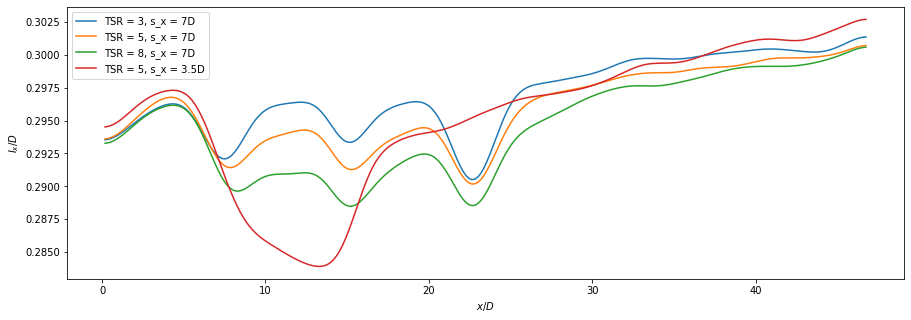

In [2]:
A1 = np.load('TSR_3_sx_7D_wave.npz')
A2 = np.load('TSR_5_sx_7D_wave.npz')
A3 = np.load('TSR_8_sx_7D_wave.npz')
A4 = np.load('TSR_5_sx_3p5D_wave.npz')

plt.figure(figsize=(15,5))
plt.plot(A1["x_bin"]/0.4,gfilter(A1["I_scale"],6)/0.4,label='TSR = 3, s_x = 7D')
plt.plot(A2["x_bin"]/0.4,gfilter(A2["I_scale"],6)/0.4,label='TSR = 5, s_x = 7D')
plt.plot(A3["x_bin"]/0.4,gfilter(A3["I_scale"],6)/0.4,label='TSR = 8, s_x = 7D')
plt.plot(A4["x_bin"]/0.4,gfilter(A4["I_scale"],6)/0.4,label='TSR = 5, s_x = 3.5D')
plt.xlabel('$x/D$')
plt.ylabel('$I_x/D$')
plt.legend(loc='best')

In [ ]:
np.max(np.diff(x_bin))/0.4

In [ ]:
(xi[256]-xi[0])/0.4

In [ ]:
2048/256